# CNN Trainig Templete
## Based on Tensorlfow - CNN MNIST example
https://github.com/tensorflow/tensorflow/blob/r1.6/tensorflow/examples/tutorials/layers/cnn_mnist.py

## Using less dataset to train the model
Training dataset - 600   
Test dataset - 120  
훈련 안 됨

## 필요한 library 호출

In [1]:
from __future__ import absolute_import
from __future__ import division
from __future__ import print_function

import numpy as np
import tensorflow as tf

import cv2

import os

tf.logging.set_verbosity(tf.logging.INFO)

## CNN model 설계
현재는 MNIST에 사용된 것으로, 추후 그물 찢김에 적용하기 위해 수정 필요

### Input Layer
Input Image Pixel: 28x28  
Color channel: 1 (grayscale)  

### 1st Conv Layer
Num of filter: 32  
Kernel size: 5x5  
Padding: Same  
Activation: ReLU  
Padding same은 입/출력이 같은 크기를 갖도록 padding하는 것  

### 1st Pooling Layer
Max pooling  
Size: 2x2  
Stride: 2  
Max pooling 시 size의 폭과 stride가 같으면 pooling window가 서로 겹치지 않음  

### 2nd Conv Layer
Num of filter: 64  
Kernel size: 5x5  
Padding: Same  
Activation: ReLU  

### 2nd Pooling Layer
Max pooling  
Size: 2x2  
Stride: 2  


### 3rd, 4th, 5th


### Dense Layer
Fully connected  

### Drop out
Rate: 0.4 (40%)  
훈련 중 40%의 connection이 임의로 제거됨  
Overfitting 방지  
뇌의학에서도 학습을 반복할수록 사람 뇌의 뉴런은 일부 connection이 끊어지면서 더 확실하게 학습한다고 함  

### Logits Layer
Binaray classification  

### Training
Loss function: Softmax Cross Entropy  
Optimizer: Gradient Descent  
Learning rate: 0.001  

In [2]:
def cnn_model_fn(features, labels, mode):
    
    """Model function for CNN."""
    # Input Layer
    # Reshape X to 4-D tensor: [batch_size, height, width, channels]
    # Our Fishing net image size is 640x480 and 3-channel (RGB)
    input_layer = tf.reshape(features["x"], [-1, 480, 640, 3])

    # Convolutional Layer #1
    # Computes 48 features using a 5x5 filter with ReLU activation.
    # Padding is added to preserve width and height.
    # Input Tensor Shape: [batch_size, 480, 640, 3]
    # Output Tensor Shape: [batch_size, 480, 640, 48]
    conv1 = tf.layers.conv2d(
        
        inputs=input_layer,
        filters=48,
        kernel_size=[5, 5],
        padding="same",
        activation=tf.nn.relu)
    print(conv1.shape)

    # Pooling Layer #1
    # First max pooling layer with a 2x2 filter and stride of 2
    # Input Tensor Shape: [batch_size, 480, 640, 48]
    # Output Tensor Shape: [batch_size, 240, 320, 48]
    pool1 = tf.layers.max_pooling2d(inputs=conv1, pool_size=[2, 2], strides=2)
    print(pool1.shape)

    # Convolutional Layer #2
    # Computes 96 features using a 5x5 filter.
    # Padding is added to preserve width and height.
    # Input Tensor Shape: [batch_size, 240, 320, 48]
    # Output Tensor Shape: [batch_size, 240, 320, 96]
    conv2 = tf.layers.conv2d(
        inputs=pool1,
        filters=96,
        kernel_size=[5, 5],
        padding="same",
        activation=tf.nn.relu)
    print(conv2.shape)

    # Pooling Layer #2
    # Second max pooling layer with a 2x2 filter and stride of 2
    # Input Tensor Shape: [batch_size, 240, 320, 96]
    # Output Tensor Shape: [batch_size, 120, 160, 96]
    pool2 = tf.layers.max_pooling2d(inputs=conv2, pool_size=[2, 2], strides=2)
    print(pool2.shape)

    
    
    
    # Input Tensor Shape: [batch_size, 120, 160, 96]
    # Output Tensor Shape: [batch_size, 120, 160, 96]    
    conv3 = tf.layers.conv2d(
        inputs=pool2,
        filters=96,
        kernel_size=[5, 5],
        padding="same",
        activation=tf.nn.relu)
    print(conv3.shape)
    
    # Input Tensor Shape: [batch_size, 120, 160, 96]
    # Output Tensor Shape: [batch_size, 60, 80, 96]
    pool3 = tf.layers.max_pooling2d(inputs=conv3, pool_size=[2, 2], strides=2)
    print(pool3.shape)
    
    
    
    # Input Tensor Shape: [batch_size, 60, 80, 96]
    # Output Tensor Shape: [batch_size, 60, 80, 96]    
    conv4 = tf.layers.conv2d(
        inputs=pool3,
        filters=96,
        kernel_size=[5, 5],
        padding="same",
        activation=tf.nn.relu)
    print(conv4.shape)
    
    # Input Tensor Shape: [batch_size, 60, 80, 96]
    # Output Tensor Shape: [batch_size, 30, 40, 96]
    pool4 = tf.layers.max_pooling2d(inputs=conv4, pool_size=[2, 2], strides=2)
    print(pool4.shape)
    
    
    
    # Input Tensor Shape: [batch_size, 30, 40, 96]
    # Output Tensor Shape: [batch_size, 30, 40, 96]    
    conv5 = tf.layers.conv2d(
        inputs=pool4,
        filters=96,
        kernel_size=[5, 5],
        padding="same",
        activation=tf.nn.relu)
    print(conv5.shape)
    
    # Input Tensor Shape: [batch_size, 30, 40, 96]
    # Output Tensor Shape: [batch_size, 15, 20, 96]
    pool5 = tf.layers.max_pooling2d(inputs=conv5, pool_size=[2, 2], strides=2)
    print(pool5.shape)
    
    
    
    
    # Flatten tensor into a batch of vectors
    # Input Tensor Shape: [batch_size, 15, 20, 96]
    # Output Tensor Shape: [batch_size, 15 * 20 * 96]
    pool5_flat = tf.reshape(pool5, [-1, 15 * 20 * 96])
    print(pool5_flat.shape)


    # Dense Layer
    # Densely connected layer with 1024 neurons
    # Input Tensor Shape: [batch_size, 15 * 20 * 96]
    # Output Tensor Shape: [batch_size, 1024]
    dense = tf.layers.dense(inputs=pool5_flat, units=1024, activation=tf.nn.relu)
    print(dense.shape)

    # Add dropout operation; 0.6 probability that element will be kept
    dropout = tf.layers.dropout(
        inputs=dense, rate=0.4, training=mode == tf.estimator.ModeKeys.TRAIN)

    # Logits layer
    # Input Tensor Shape: [batch_size, 1024]
    # Output Tensor Shape: [batch_size, 1]
    logits = tf.layers.dense(inputs=dropout, units=2)
    print(logits.shape)

    predictions = {
        # Generate predictions (for PREDICT and EVAL mode)
        "classes": tf.argmax(input=logits, axis=1),
        # Add `softmax_tensor` to the graph. It is used for PREDICT and by the
        # `logging_hook`.
        "probabilities": tf.nn.softmax(logits, name="softmax_tensor")
    }
    if mode == tf.estimator.ModeKeys.PREDICT:
        return tf.estimator.EstimatorSpec(mode=mode, predictions=predictions)

    # Calculate Loss (for both TRAIN and EVAL modes)
    loss = tf.losses.sparse_softmax_cross_entropy(labels=labels, logits=logits)
    # sparse_softmax_cross_entropy cannot use one-hot encoding
    
    #loss = tf.nn.sigmoid_cross_entropy_with_logits(labels=labels, logits=logits)

    # Configure the Training Op (for TRAIN mode)
    if mode == tf.estimator.ModeKeys.TRAIN:
        optimizer = tf.train.GradientDescentOptimizer(learning_rate=0.001)
        train_op = optimizer.minimize(
            loss=loss,
            global_step=tf.train.get_global_step())
        return tf.estimator.EstimatorSpec(mode=mode, loss=loss, train_op=train_op)

    # Add evaluation metrics (for EVAL mode)
    eval_metric_ops = {
        "accuracy": tf.metrics.accuracy(
            labels=labels, predictions=predictions["classes"])}
    return tf.estimator.EstimatorSpec(
        mode=mode, loss=loss, eval_metric_ops=eval_metric_ops)

## Code Run


### Training
Batch size: 128  
Epoch: 5  
Shuffle: True  
Step: 20000

## Loading dataset
Load dataset and split them into training data and evaluation data

파손, 정상 비율 1:1??

In [3]:
# torn: 0-1484
# untorn: 0-1779
num_torn = 360
num_untorn = 360
total_pix = 480*640*3

torn_data = np.zeros((num_torn, total_pix), dtype=np.float32)
print(torn_data.shape)
untorn_data = np.zeros((num_untorn, total_pix), dtype=np.float32)

(360, 921600)


In [10]:
num_torn_max = 1485
num_untorn_max = 1780

torn_idx = np.random.choice(np.arange(num_torn_max), num_torn)
untorn_idx = np.random.choice(np.arange(num_untorn_max), num_untorn)
print(torn_idx)

np.random.shuffle(torn_idx)
np.random.shuffle(untorn_idx)

print(torn_idx)

[  24  745  594 1408  681  875  411 1459  193  920  963  988 1272 1316 1203
  642 1279  656  535  841 1346 1187 1215 1096  151 1329 1474 1458  616  656
 1356  698  947   54 1418  102  333  784    5 1343   16 1302  923 1076  866
  447  953  891 1178 1320  531   91  707 1351 1391 1277   62  972   68  671
  851  581 1425  314    3  823  107  629  213  607 1428  100 1062  564 1228
  529  860  997  420  990  916  925  580 1450  919  718  954  581  274  805
  636 1104 1052  339  556  898  813  681 1016  874 1442  160 1269 1389  818
  894  612  996 1024  203   34  893  828 1280  440  193   86  244  211  379
  251 1031  275 1104  129 1309 1265  593  988  252  644  826  316  537 1157
  864  834  311  234  695  828  237 1229  725 1232  995 1023  744  266  723
 1240  438  896  628  924  735  234 1225 1442 1280 1449  653 1155  634  297
 1391  776  856  626 1189  347  896  316 1014  530  513  422 1149 1326  818
 1083 1314  967  629 1392  434  595  515 1412  450  400  598  227  534 1188
  523 1307 1

In [14]:
for i in range(num_torn):
    img = cv2.imread("D:/Files/dataset/torn/img-%04d.png" % torn_idx[i])
    print(torn_idx[i])
    torn_data[i][:] = img.flatten()

916
165
1021
1180
1147
1316
718
598
166
211
1317
129
1016
1307
237
1474
1229
960
1279


AttributeError: 'NoneType' object has no attribute 'flatten'

In [6]:
for i in range(num_untorn):
    img = cv2.imread("D:\Files\dataset\untorn\img-%04d.png" % untorn_idx[i]).flatten()
    untorn_data[i][:] = img

In [7]:
torn_label = np.full((num_torn,1), 1, dtype=np.float32)
untorn_label = np.full((num_untorn,1), 0, dtype=np.float32)

In [8]:
# 80% training, 20% evaluation
tr_rate = 600/720
num_tr_torn = int(tr_rate * num_torn)
num_ev_torn = num_torn - num_tr_torn
print(num_tr_torn, num_ev_torn)

num_tr_untorn = int(tr_rate * num_untorn)
num_ev_untorn = num_untorn - num_tr_untorn
print(num_tr_untorn, num_ev_untorn)

tr_torn = torn_data[:num_tr_torn][:]
ev_torn = torn_data[num_tr_torn:][:]
print(tr_torn.shape)
print(ev_torn.shape)

tr_untorn = untorn_data[:num_tr_untorn][:]
ev_untorn = untorn_data[num_tr_untorn:][:]
print(tr_untorn.shape)
print(ev_untorn.shape)



tr_data = np.append(tr_torn, tr_untorn, axis=0)
print(tr_data.shape)
ev_data = np.append(ev_torn, ev_untorn, axis=0)
print(ev_data.shape)

tr_label = np.append(np.full((num_tr_torn), 1, dtype=np.int32), np.full((num_tr_untorn), 0, dtype=np.int32))
ev_label = np.append(np.full((num_ev_torn), 1, dtype=np.int32), np.full((num_ev_untorn), 0, dtype=np.int32))
print(tr_label.shape[0], ev_label.shape[0])

300 60
300 60
(300, 921600)
(60, 921600)
(300, 921600)
(60, 921600)
(600, 921600)
(120, 921600)
600 120


In [9]:
shuf1 = np.arange(tr_label.shape[0])
np.random.shuffle(shuf1)
print(shuf1)

shuf2 = np.arange(ev_label.shape[0])
np.random.shuffle(shuf2)
print(shuf2)

tr_data_sh = np.zeros((tr_data.shape), dtype=np.float32)
tr_label_sh = np.zeros((tr_label.shape), dtype=np.int32)
ev_data_sh = np.zeros((ev_data.shape), dtype=np.float32)
ev_label_sh = np.zeros((ev_label.shape), dtype=np.int32)


for i in range(tr_label.shape[0]):
    tr_data_sh[i][:] = tr_data[shuf1[i]][:]
    tr_label_sh[i] = tr_label[shuf1[i]]
    
for i in range (ev_label.shape[0]):
    ev_data_sh[i][:] = ev_data[shuf2[i]][:]
    ev_label_sh[i] = ev_label[shuf2[i]]

[265 488 333 113  60  78  24 365 201 398 223 287 319 195 427 565 507 503
 437 339 569 327 527 447 204 226 404 334 307 500 397 592   6 193 477 493
 354 395 294 289 234 185 508 187 241 424  56 418 491 580  79 154 448 350
 405 313 167 178  15 359  40 509 444 406 385 221 417 361 341 143 498  58
 535 439 131 464 266 196 429 123 467 431  23   2 389 400 326 591 126 246
 173 203 596 132  47  84 475 100 377 264 202  32 436 468 165 435 137 571
 101   4   3 412  66  26 252  45 537 209 106 141 105 276  72 182  11 426
 460 586 420 360 274 147  10 206 513 364 482 396 278  91 151 573 328 369
 544 164 523 181 179 149 297 518  49 127 568 261 253 597 191 279 432 486
  21 347 260 430  74 532 370 536 556 501 296 248 497 454  14 262 237 388
 314 375 563 357 125  63 495 218 411 519  76 292 492 583  51 368 155 116
 538 443 366 346 504  31  44 403  46 145  33 320 574 220 232 581 483 481
 471 408  48 109  77 176 356 599 480 516 250 216 163 214 283  96 547 514
   8 410   1 267  28  61 496  93 128 387 558 233 45

In [10]:
config = tf.ConfigProto()
config.gpu_options.per_process_gpu_memory_fraction = 0.5
session = tf.Session(config=config)

# Create the Estimator
net_classifier = tf.estimator.Estimator(
    model_fn=cnn_model_fn, model_dir="D:\OneDrive\Develop\temp-models\CNN600")

# Set up logging for predictions
# Log the values in the "Softmax" tensor with label "probabilities"
tensors_to_log = {"probabilities": "softmax_tensor"}
logging_hook = tf.train.LoggingTensorHook(
    tensors=tensors_to_log, every_n_iter=50)

batch_s = 1
epochs = 5
tr_steps = int(tr_data.shape[0]/batch_s*epochs)
in_steps = 1


# Train the model
train_input_fn = tf.estimator.inputs.numpy_input_fn(
    x={"x": tr_data},
    y=tr_label,
    batch_size=batch_s,
    num_epochs=epochs,
    shuffle=True)
net_classifier.train(
    input_fn=train_input_fn,
    steps=20000,
    hooks=[logging_hook])

INFO:tensorflow:Using default config.
INFO:tensorflow:Using config: {'_keep_checkpoint_max': 5, '_task_type': 'worker', '_model_dir': '/models/CNN600', '_save_checkpoints_steps': None, '_session_config': None, '_service': None, '_evaluation_master': '', '_num_ps_replicas': 0, '_keep_checkpoint_every_n_hours': 10000, '_task_id': 0, '_is_chief': True, '_master': '', '_tf_random_seed': None, '_log_step_count_steps': 100, '_save_summary_steps': 100, '_cluster_spec': <tensorflow.python.training.server_lib.ClusterSpec object at 0x7f994c2f4b70>, '_save_checkpoints_secs': 600, '_global_id_in_cluster': 0, '_num_worker_replicas': 1}
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Create CheckpointSaverHook.
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:R

In [11]:
config = tf.ConfigProto()
config.gpu_options.per_process_gpu_memory_fraction = 0.7
session = tf.Session(config=config)

ev_results = np.zeros((len(ev_label), 1))

# Evaluate the model and print results
for i in range(len(ev_label)):
    eval_input_fn = tf.estimator.inputs.numpy_input_fn(
        x={"x": ev_data_sh[i:i+1]},
        y=ev_label_sh[i:i+1],
        num_epochs=1,
        shuffle=False)
    eval_results = net_classifier.evaluate(input_fn=eval_input_fn)

    ev_results[i] = eval_results["accuracy"]

INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 2018-04-19-06:58:58
INFO:tensorflow:Graph was finalized.
INFO:tensorflow:Restoring parameters from /models/CNN600/model.ckpt-18000
INFO:tensorflow:Running local_init_op.
INFO:tensorflow:Done running local_init_op.
INFO:tensorflow:Finished evaluation at 2018-04-19-06:58:58
INFO:tensorflow:Saving dict for global step 18000: accuracy = 0.0, global_step = 18000, loss = 0.6966824
INFO:tensorflow:Calling model_fn.
(?, 480, 640, 48)
(?, 240, 320, 48)
(?, 240, 320, 96)
(?, 120, 160, 96)
(?, 120, 160, 96)
(?, 60, 80, 96)
(?, 60, 80, 96)
(?, 30, 40, 96)
(?, 30, 40, 96)
(?, 15, 20, 96)
(?, 28800)
(?, 1024)
(?, 2)
INFO:tensorflow:Done calling model_fn.
INFO:tensorflow:Starting evaluation at 20

## Results
Training step 6000: 50%

In [12]:
print(np.mean(ev_results))

0.5


In [13]:
fail_idx = np.where(ev_results == 0)
print(fail_idx[0])
print(len(fail_idx[0]))

[  0   4   7  13  17  19  21  22  23  24  26  27  29  31  32  34  35  36
  37  39  41  42  48  49  53  55  57  58  61  63  64  65  67  70  71  72
  75  76  77  78  80  84  85  86  89  90  92  95  99 100 101 102 106 109
 110 112 114 115 116 119]
60


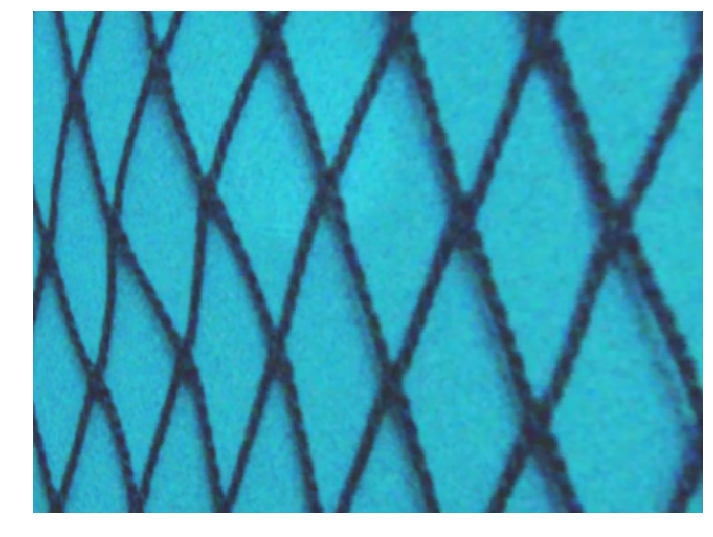

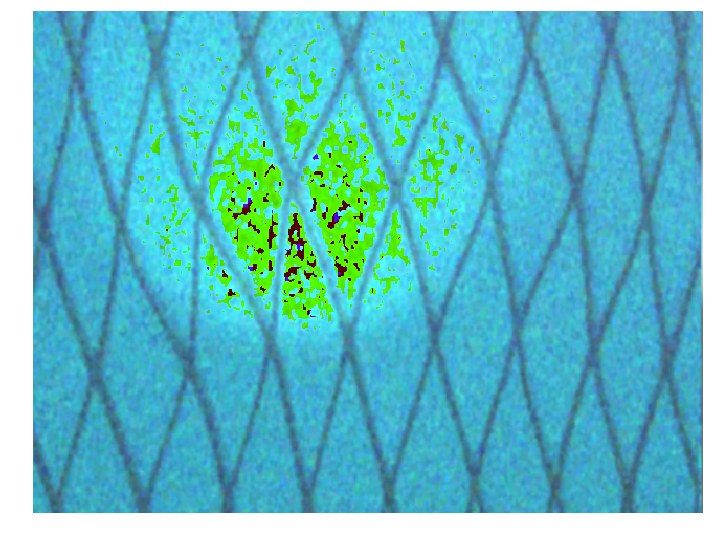

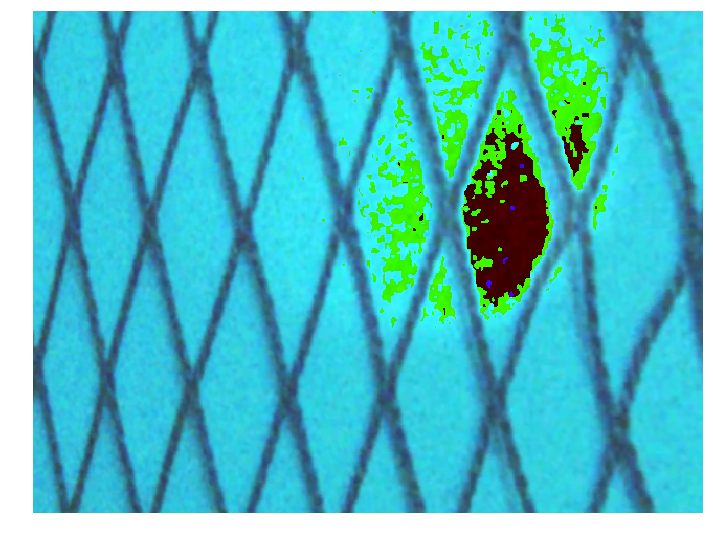

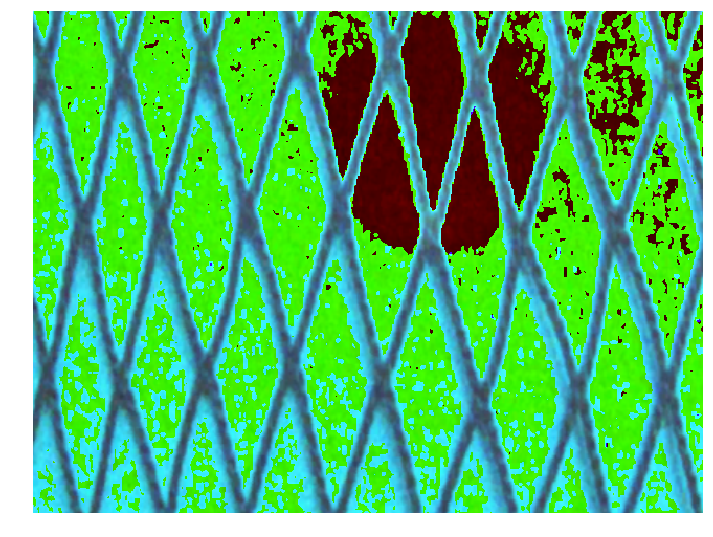

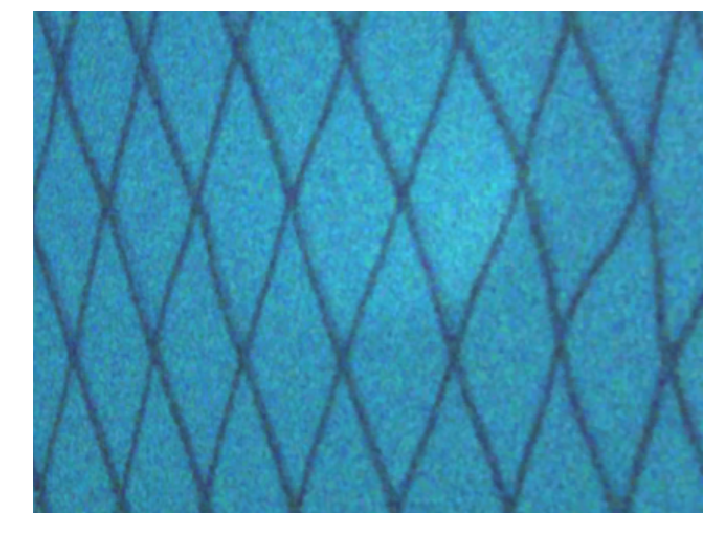

...

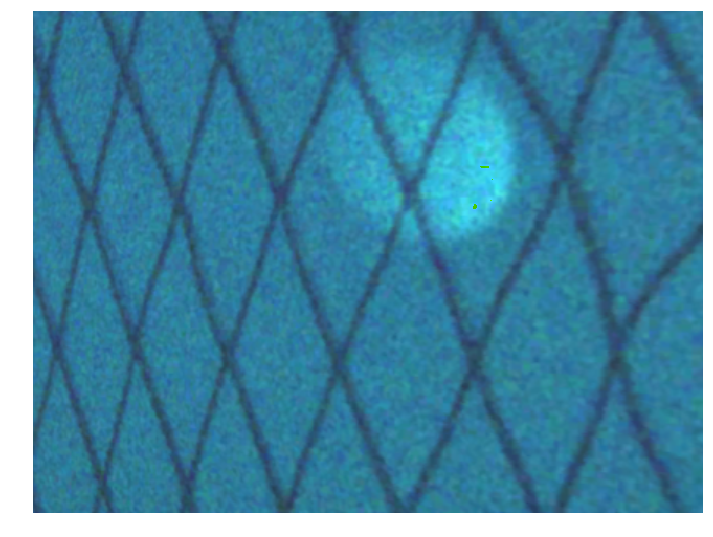

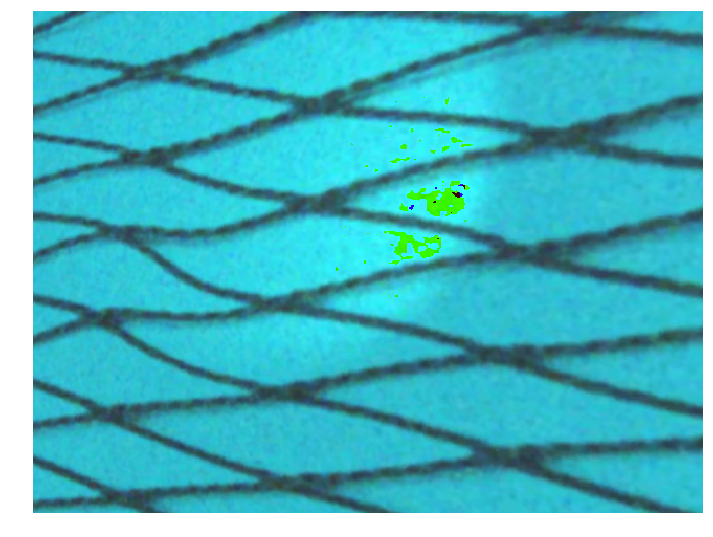

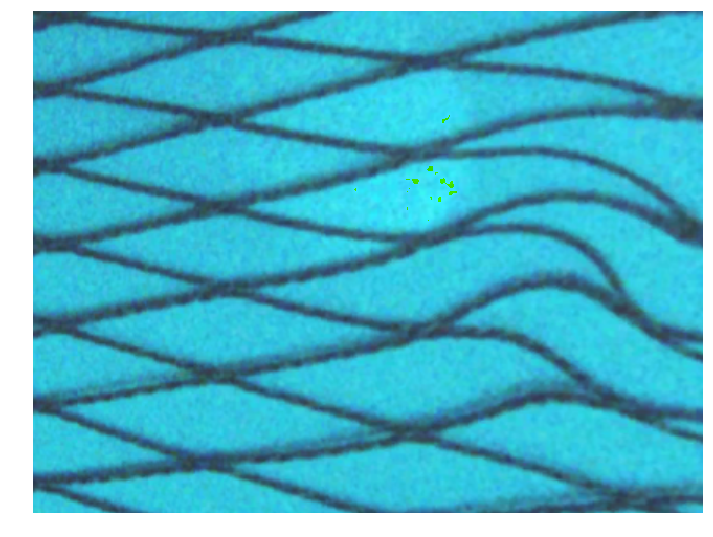

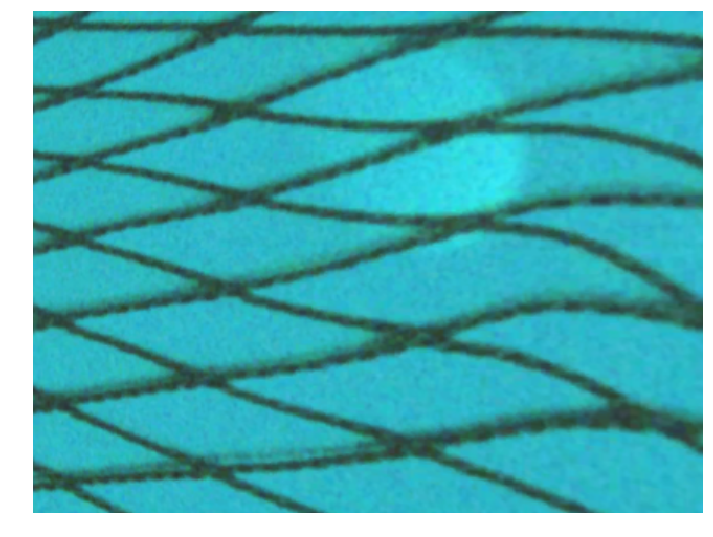

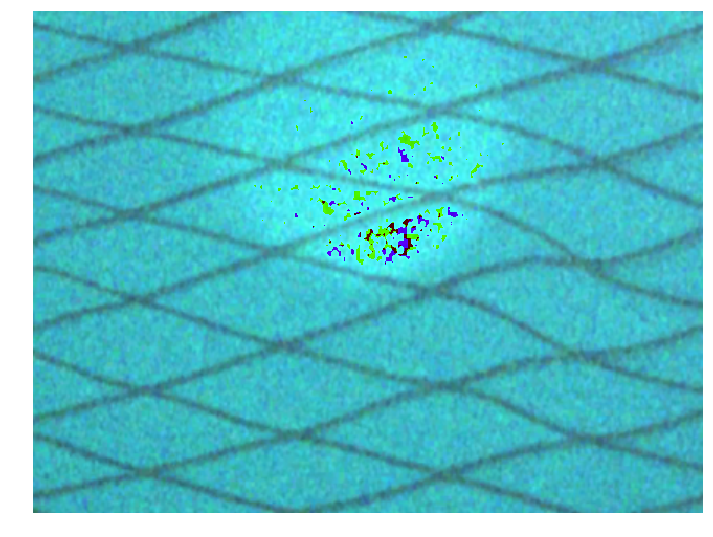

In [14]:
%matplotlib inline
import matplotlib.pyplot as plt


for i in range(len(fail_idx[0])):

    temp_img = ev_data_sh[fail_idx[0][i]][:].reshape([480, 640, 3])

    temp_img = 255-temp_img

    width = 12
    height = 12
    plt.figure(figsize=(width, height))
    plt.axis("off")
    plt.imshow(cv2.cvtColor(temp_img, cv2.COLOR_BGR2RGB))
    plt.show()

## Results
훈련 데이터셋 2612개  
검증 데이터셋 653개  
  
정확도 87.7%  
  
CNN layer 5개  
Training step: 40000회  
Batch size: 1  
